# Tratamiento de imágenes  2024 - Entregable 1
# Fecha de entrega: Jueves 18/4

**Importante:** En todos los ejercicios se espera que se entregue comentarios sobre decisiones tomadas en la implementación así como un análisis de los resultados. Estos comentarios y análisis se pueden entregar en celdas de texto agregadas a los notebooks o en un informe aparte.

Para la entrega se sube un **zip** (no rar, ni otro formato) con:
* El notebook del entregable modificado. El notebook debe tener las celdas ejecutadas con las salidas correspondientes. Debe tener todo lo necesario para poder ser ejecutado nuevamente
* Todo el resto del contenido del zip del entregable. Si, para mostrar resultados, usan en el notebook imágenes propias, deben incluirlas en la carpeta **imagenes**  del zip. 
* El informe en pdf en caso de no incluir las discusiones dentro del notebook en celdas "Markdown", o si les resulta más sencillo realizar el análisis en un documento aparte.

**No se deben incluir en el zip de la entrega las imágenes de prueba que están disponibles en la página web del curso**. Se asumirá que esas imágenes están en un directorio y se hará referencia a dichas imágenes en forma relativa a ese directorio (ver la celda siguiente).
   

In [20]:
# Directorio con la base de imágenes de prueba (las que están en la web de Timag)
# Ej. si usan la imagen trapo.jpg en el notebook no tienen que subirla al eva
# La llaman en el notebook en forma relativa a donde tengan esas imagenes:
# 
# filename = os.path.join(dir_base_imagenes, 'trapo.jpg')
# I = imread(filename)
dir_base_imagenes = '../base_imagenes'

In [21]:
import os
import numpy as np
from matplotlib import pyplot as plt
from skimage.io import imread, imsave
import cv2
from scipy.fftpack import fft2, ifft2, fftshift
from skimage.restoration import wiener, richardson_lucy

# FORMAS DE VER LAS GRAFICAS --------------------
# ELEGIR UNA DE LAS OPCIONES Y DES-COMENTAR (sacar # de la linea)
# ----------------
# a) graficas en línea  entre las celdas (no interactivo)
# %matplotlib inline
# ---------------- 
# b) graficas en línea  entre las celdas (interactivo)
# %matplotlib notebook
# ----------------
# c) graficas en ventanas externas (abre una ventana por cada figura)
# %matplotlib
# ----------------
# d) Si se usa "jupyter lab" en lugar de "jupyter notebook" usar %matplotlib widget en lugar de %matplotlib notebook 
# requiere instalar el modulo "ipympl". Ver https://stackoverflow.com/questions/51922480/javascript-error-ipython-is-not-defined-in-jupyterlab#56416229
# %matplotlib widget
#---------------------------------------------------


## 1) Líneas de nivel

Escribir un programa que reciba una imagen y un conjunto de valores y muestre las líneas de nivel correspondientes a dichos valores. Para ello implementar el algoritmo marching squares (Ver por ejemplo: https://en.wikipedia.org/wiki/Marching_squares).

Aplicarlo a imágenes naturales y artificiales y comparar los resultados con los de la función contour (https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.contour.html). 

Imágenes artificiales sugeridas: cono.png, pliegues.png, oclusion.png


In [22]:
def interpolacionLineal(p, q, nivel, caso):
    """realiza la interpolacion lineal entre los pixeles p y q, dado un nivel para el que se quiere calcular la linea de nivel

    Args:
        p (int): pixel desde el cual quiero medir la distancia para trazar la linea (si dis=0 trazo la linea desde p)
        q (int): pixel limite del intervalo en el cual quiero trazar la linea (si dis=1 trazo la linea desde q)
        nivel (_type_): valor del lambda de la curva de nivel que se esta calculando
        caso (_type_): (solo para imprimir en caso de error, caso segun matching squares)

    Returns:
        _type_: _description_
    """
    # p tiene que ser desde donde quiero tener en cuenta la distancia que devuelvo
    # q es el limite, si dis=1 estoy en q
    if (p < q):
        dis = (nivel - p) / (q-p)
    else:
        dis = 1-((nivel - q)/ (p-q))
    assert dis<=1, f"caso: {caso}, p={p}, q={q}, dis={dis}"
    return dis



def lineas_nivel(I:np.ndarray, niveles:list, plot:bool=True):
    """calcula las lineas de nivel para la imagen I, luego plotea la imagen con sus curvas de nivel por encima

    Args:
        I (numpy.ndarray): imagen
        niveles (list): lista con los valores para los que se quiere calcular las lineas de nivel
        plot(bool): indica si se desea plotear o no. Defaults to True

    Returns:
        list: lista de largo len(niveles), dentro de cada una de esas lista se encuentran tuplas con 
                los segmentos a plotear en formato ([x1, x2], [y1, y2])
    """
    
    alto, ancho = I.shape[:2]
    cant_niveles = len(niveles)
    segmentos=[[] for _ in range(cant_niveles)] #genero una lista vacia para cada curva de nivel que quiero calcular, 
                                                # en estas listas voy a guardar los segmentos a plotear
    if I.ndim>2:
        I = I[:,:,0]
    
    for count, value in enumerate(niveles):
        #para cada valor de curva de nivel que me pasaron como argumento, recorro todos los pixeles de la imagen calculando la curva de nivel
        for i in range(alto-1):
            for j in range(ancho-1):
                # obtengo flags que indican si cada uno de los 4 pixeles del cuadrado de 
                # matching squares es mayor o igual al valor de la curva de nivel que quiero plotear
                pix11 = (I[i,j]>=value)
                pix12 = (I[i,j+1]>=value)
                pix21 = (I[i+1,j]>=value)
                pix22 = (I[i+1,j+1]>=value)
                
                # guardo los valores de cada pixel para la interpolacion lineal
                p11 = I[i,j]
                p12 = I[i,j+1]
                p21 = I[i+1,j]
                p22 = I[i+1,j+1]
                
                # en base a las flags me fijo en que caso de los 16 posibles me encuentro
                caso=0
                if pix11: caso+=8
                if pix12: caso+=4
                if pix21: caso+=1
                if pix22: caso+=2
                
                
                if caso==0 or caso==15:
                    # en este caso no tengo que plotear ningun segmento
                    pass
                
                if caso==1 or caso==14:
                    # primero calculo los puntos que son los extrermos del segmento
                    x1 = 0
                    y1 = interpolacionLineal(p11, p21, value, caso)
                    x2 = interpolacionLineal(p21, p22, value, caso)
                    y2 = 1
                    #luego agrergo los extremos del segmento a la curva de nivel correspondiente al valor con el que estoy trabajando
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))

                
                if caso==2 or caso==13:
                    x1 = interpolacionLineal(p21, p22, value, caso)
                    y1 = 1
                    x2 = 1
                    y2 = interpolacionLineal(p12, p22, value, caso)
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                    
                    
                if caso==3 or caso==12:
                    x1 = 0
                    y1 = interpolacionLineal(p11, p21, value, caso)
                    x2 = 1
                    y2 = interpolacionLineal(p12, p22, value, caso)
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                
                
                if caso==4 or caso==11:
                    x1 = interpolacionLineal(p11, p12, value, caso)
                    y1 = 0
                    x2 = 1
                    y2 = interpolacionLineal(p12, p22, value, caso)
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                
                
                if caso==5:
                    # en este caso son dos los segmentos a plotear
                    x1 = interpolacionLineal(p21, p22, value, caso)
                    y1 = 1
                    x2 = 1
                    y2 = interpolacionLineal(p12, p22, value, caso)
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                    
                    x1 = 0
                    y1 = interpolacionLineal(p11, p21, value, caso)
                    x2 = interpolacionLineal(p11, p12, value, caso)
                    y2 = 0
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                    
                    
                if caso==10:
                    # en este caso son dos los segmentos a plotear
                    x1 = interpolacionLineal(p11, p12, value, caso)
                    y1 = 0
                    x2 = 1
                    y2 = interpolacionLineal(p12, p22, value, caso)
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                    
                    x1 = 0
                    y1 = interpolacionLineal(p11, p21, value, caso)
                    x2 = interpolacionLineal(p21, p22, value, caso)
                    y2 = 1
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                    
                    
                if caso==6 or caso==9:
                    x1 = interpolacionLineal(p11, p12, value, caso)
                    y1 = 0
                    x2 = interpolacionLineal(p21, p22, value, caso)
                    y2 = 1
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                    
                    
                if caso==7 or caso==8:
                    x1 = 0
                    y1 = interpolacionLineal(p11, p21, value, caso)
                    x2 = interpolacionLineal(p11, p12, value, caso)
                    y2 = 0
                    segmentos[count].append(([j+x1, j+x2], [i+y1, i+y2]))
                    
                    
    # si plot==True, ploteo la imagen con las curvas de nivel encima
    if plot:
        plt.figure()
        plt.imshow(I, cmap='gray')
        
        colores = ['blue', 'green', 'red']
        index_color = 0
        
        for count, value in enumerate(segmentos):
            index_color = (index_color + 1) % 3
            for seg in value:
                # plt.plot(seg[0], seg[1], 'go-')
                plt.plot(seg[0], seg[1], color=colores[index_color], linestyle='-', linewidth=1)  
        
        plt.title(f'curva de nivel para los valores: {niveles}')
        plt.show()
        
        
    return segmentos




def plot_lineas_nivel(I:np.ndarray, segmentos:list, niveles:list, figura=None, mostrar_imagen=True, titulo=None):
    """funcion que plotea lineas de nivel ya calculadas

    Args:
        I (np.ndarray): imagen a la cual corresponden las lineas de nivel
        segmentos (list): lista resultado de llamar a la función lineas_nivel()
        niveles (list): niveles a los cuales corresponden las lineas de nivel
        figura (_type_, optional): figura en la cual plotear la imagen y las lineas de nivel, si es igual a None se crea una figura y se muestra todo en ella. Defaults to None.
        mostrar_imagen (bool, optional): booleano que indica si se muestra la imagen devajo de las lineas. Defaults to True.
        
    """
    colores = ['blue', 'green', 'red']
    index_color = 0
        
    if figura==None:
        #si no me pasan una figura la creo,
        figura = plt.figure()
        # muestro la imagen si asi se pide
        if mostrar_imagen:
            plt.imshow(I, cmap='gray')
    
        for count, value in enumerate(segmentos):
            #cambio el color entre los distintos niveles para que se entienda mas la figura
            index_color = (index_color + 1) % 3
            for seg in value:
                plt.plot(seg[0], seg[1], color=colores[index_color], linestyle='-', linewidth=1.5) 
        
        if titulo==None:
            plt.title(f'curva de nivel para los valores: {niveles}')
        else:
            figura.set_title(titulo)
        
        #muestro la figura
        plt.show()
    
    
    else:
        # muestro la imagen si asi se pide
        if mostrar_imagen:
            figura.imshow(I, cmap='gray')
        
        for count, value in enumerate(segmentos):
            #cambio el color entre los distintos niveles para que se entienda mas la figura
            index_color = (index_color + 1) % 3
            for seg in value:
                figura.plot(seg[0], seg[1], color=colores[index_color], linestyle='-', linewidth=1.5)
        
        if titulo==None:
            figura.set_title(f'curva de nivel para los valores: {niveles}')
        else:
            figura.set_title(titulo)

        # en este caso no muestro la figura porque fuede ser subfigura de un plot mas grande
    
    

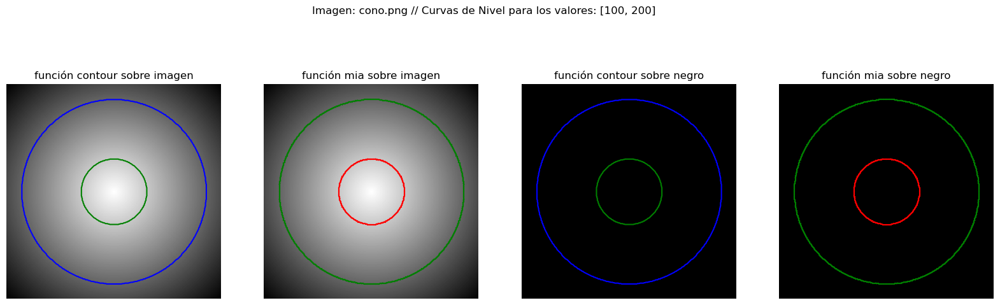

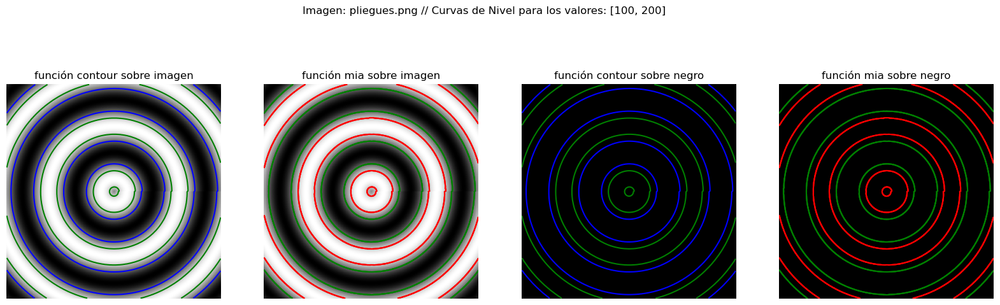

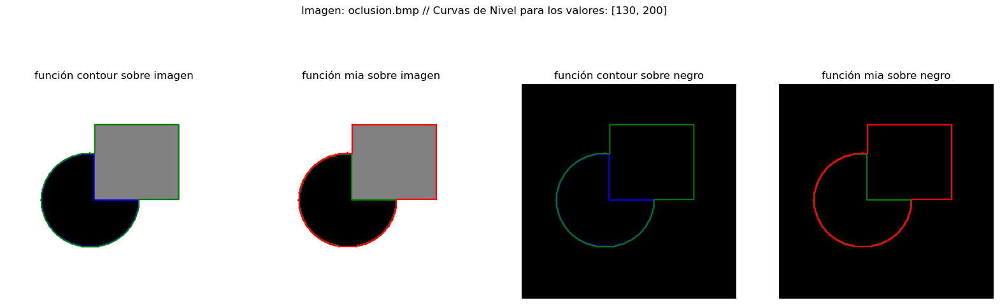

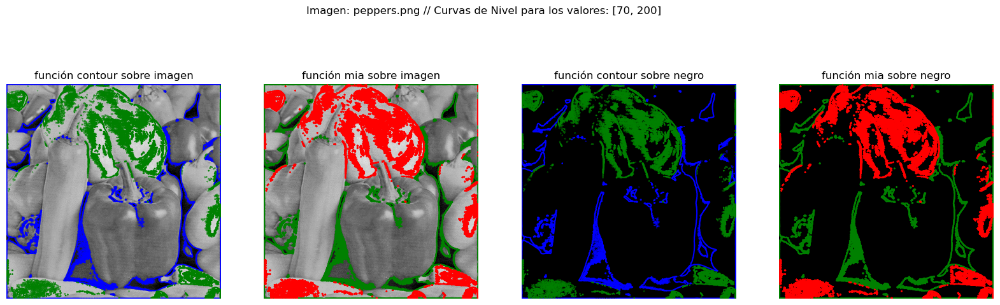

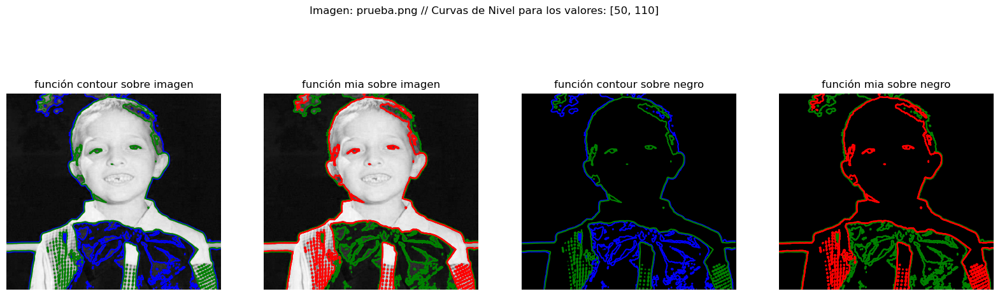

In [45]:
# Ejemplo de prueba: lineas_nivel y plt.contour deberían ser intercambiables
imagenes = ['imagenes/cono.png', 'imagenes/pliegues.png', 'imagenes/oclusion.bmp', 'imagenes/peppers.png', 'imagenes/prueba.png' ]
niveles = [[100, 200], [100, 200], [130, 200], [70, 200], [50, 110]]

for str, nivel in zip(imagenes, niveles):
    I = imread(str)
    titulo = f"Imagen: {str.split('/')[-1]} // Curvas de Nivel para los valores: {nivel}"
    
    if I.ndim>2:
        I = I[:,:,0]
    
    fig, ax = plt.subplots(1, 4, figsize=(20,6))

    ax[0].imshow(I, cmap='gray')
    ax[0].contour(I, levels=nivel, colors=['blue', 'green', 'red'])
    ax[0].set_title('función contour sobre imagen')
    ax[0].axis("off")


    segmentos = lineas_nivel(I, niveles=nivel, plot=False)
    plot_lineas_nivel(I, segmentos, niveles, ax[1])
    ax[1].set_title('función mia sobre imagen')
    ax[1].axis("off")
    
    
    ax[2].imshow(np.zeros_like(I), cmap='gray')
    ax[2].contour(I, levels=nivel, colors=['blue', 'green', 'red'])
    ax[2].set_title('función contour sobre negro')
    ax[2].axis("off")


    segmentos = lineas_nivel(I, niveles=nivel, plot=False)
    plot_lineas_nivel(np.zeros_like(I), segmentos, niveles, ax[3])
    ax[3].set_title('función mia sobre negro')
    ax[3].axis("off")
    
    fig.suptitle(titulo)
    plt.show()
    
        

Se puede observar como las funciones contour (de matplotlib) y lineas_nivel (implementada mas arriba) son intercambiables, para iguales conjuntos de valores devuelven resultados identicos, funcionando como se esperaba. En las imagenes artificiales las lineas de nivel son formas geometricas bastante perfectas, mientras que en las imagenes naturales existe la presencia de ruido y esto hace que las lineas de nivel formen recorridos mas imperfectos y entreverados.

## 2) Histograma y Ecualización

Imágenes sugeridas: parot1.png, parot2.png, strike1.png, strike2.png

**a)** Implementar una función que calcule el histograma e histograma acumulado de una imagen. Mostrar resultados para las imágenes parot1.png y parot2.png con diverso número de bins (bins=10, bins=100, bins=256). 

In [5]:
def histograma(I:np.ndarray, nBins:int, rango=None):    
    """
    Calcula el histograma de una imagen. 
    Devuelve el histograma y los bins correspondientes.
    
    Args:
        I (ndarray): La imagen de entrada.
        nBins (int): El número de bins a utilizar.
        rango (float, float), opcional. Rango mínimo y máximo para los bins. Si no 
                                        se pasa, se toma el mínimo y máximo de la imagen   

    Returns:
        histograma (1D-array de largo bins): Cantidad de muestras en cada bin
        bordes_histo (1D-array de largo bins +1): Los bordes de los bins utilizados para calcular el histograma.
    """
    
    if I.ndim>2:
        I = I[:,:,0]
    
    histograma = np.zeros(nBins)
    bordes_histo = np.zeros(nBins +1)
    
    if (rango==None):
        rango = (np.min(I), np.max(I))
        
    bordes_histo[0] = rango[0]
    
    #calculo cuantos valores hay en entre los limites del rango
    cantidad_de_valores = rango[1] - rango[0] +1
    
    #recorro los valores entre los limites del rango
    for valor in range(rango[0], rango[1]+1):
        #me fijo cuantos valores coinciden con este valor
        count = np.count_nonzero(I == valor)
        #calculo en que vin cae este valor
        bin = int((valor-rango[0]) * nBins/cantidad_de_valores)
        #sumo ya que pueden caer muchos valores en un bin
        histograma[bin]+= count
        #sobreescribo el limite del bin hasta que pase a otro, asi el último valor queda como el limite
        bordes_histo[bin+1] = valor
            
    
    return histograma, bordes_histo

def histogramaAcumulado(img, bins, rango=None):
    """
    Calcula el histograma acumulado de una imagen. 
    Devuelve el histograma acumulado y los bins correspondientes.

    Args:
        imagen (ndarray): La imagen de entrada.
        bins (int): El número de bins a utilizar.
        rango (float, float), opcional. Rango mínimo y máximo para los bins. Si no 
                                        se pasa, se toma el mínimo y máximo de la imagen

    Returns:
        histo_acumulado (1D-array de largo bins): Cantidad de muestras acumuladas en cada bin
        bin_edges (1D-array de largo bins +1): Los bordes de los bins utilizados.
    """
    histo, bordes_histo = histograma(img, bins, rango=rango)
    histo_acumulado  = np.cumsum(histo)
    
    return histo_acumulado, bordes_histo



**b)** Comparar los histogramas con la salida de la función *histogram()* de numpy para las mismas imágenes y mismos bins.

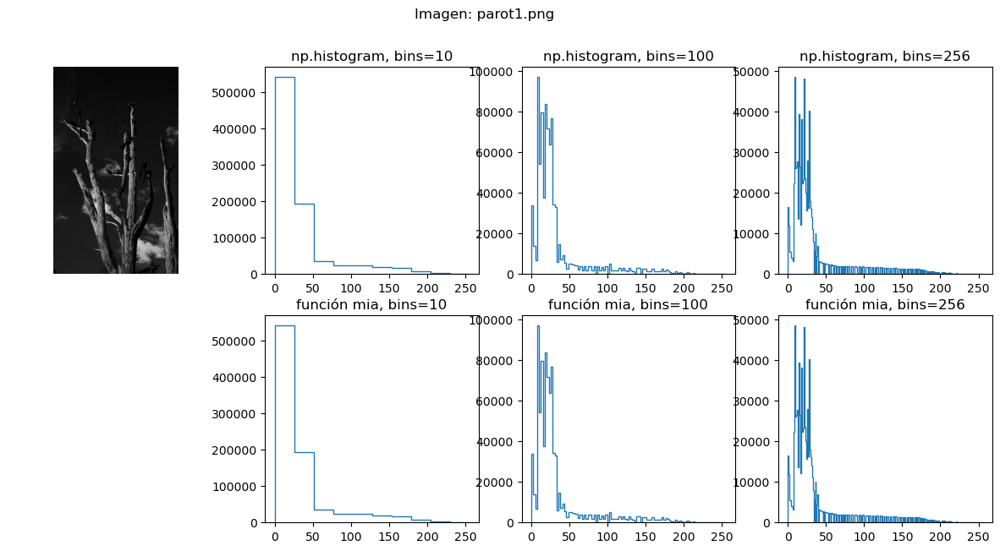

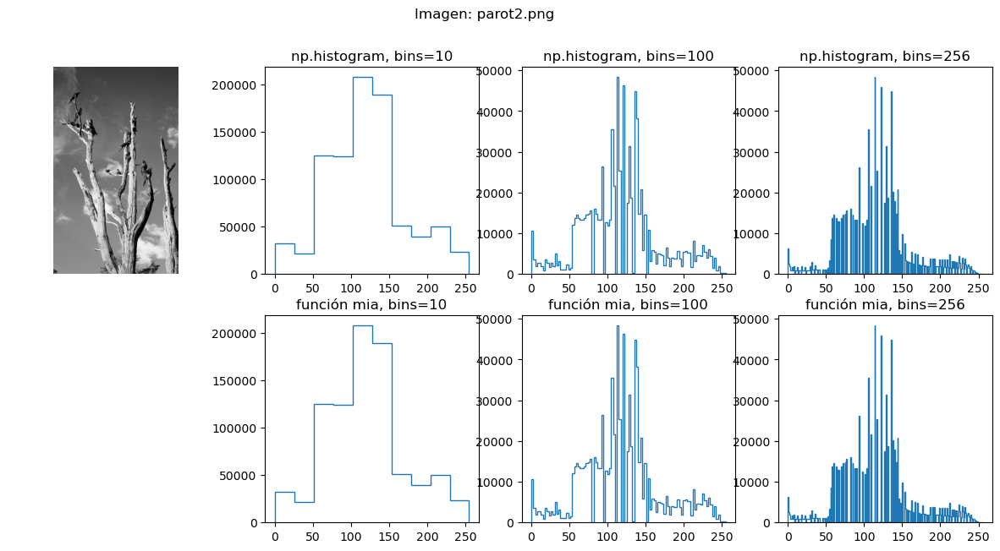

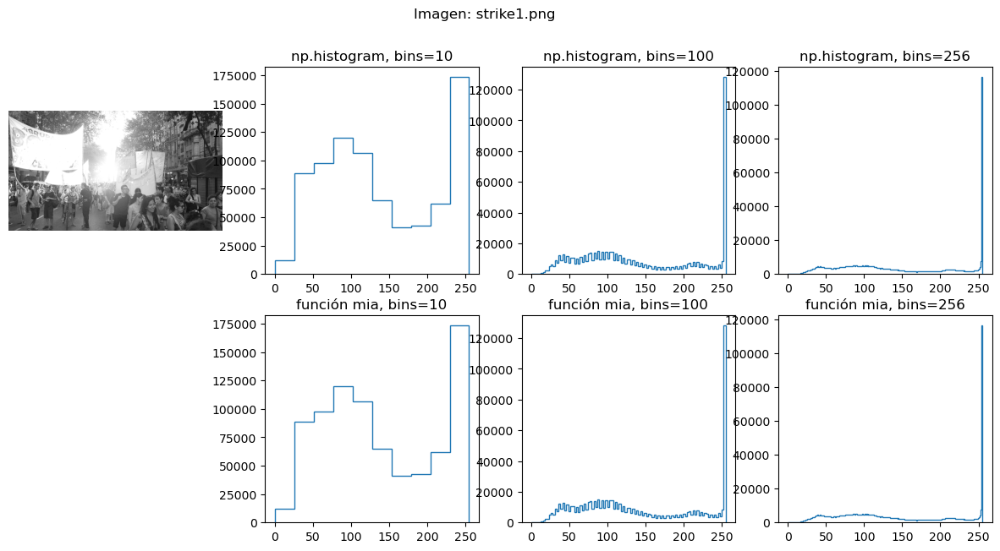

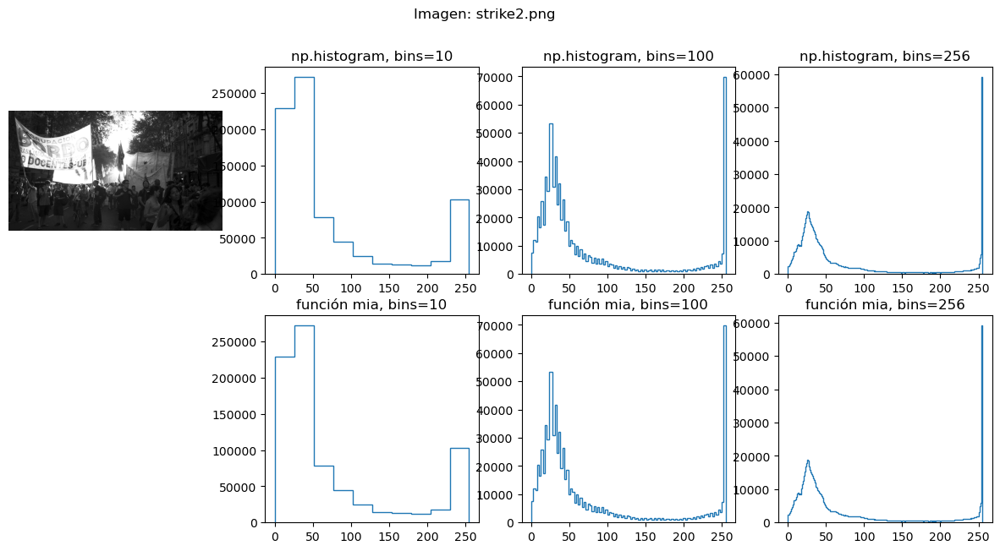

In [7]:
imagenes = ['parot1.png', 'parot2.png', 'strike1.png', 'strike2.png']
nBins = [10, 100, 256]


for str in imagenes:
    I = imread(f'imagenes/{str}')
    titulo = f'Imagen: {str}'
    
    if I.ndim>2:
        I = I[:,:,0]
        
    
    fig, ax = plt.subplots(2, 4, figsize=(15,7))
    ax[0,0].imshow(I, cmap='gray')
    ax[0,0].axis("off")
    ax[1,0].axis("off")
    
    for i, bins in enumerate(nBins):
        counts, bin_edges = np.histogram(I, bins)
        ax[0, i+1].stairs(counts, bin_edges)
        ax[0, i+1].set_title(f'np.histogram, bins={bins}')

        histo, bordes = histograma(I, bins)
        ax[1, i+1].stairs(counts, bin_edges)
        ax[1, i+1].set_title(f'función mia, bins={bins}')
    
    
    fig.suptitle(titulo)
    plt.show()


Nuevamente se puede observar como la funcion de matplotlib y la implementada en el notebook son intercambiables.

**c)** **Explicar en qué consiste** el método *`midway equalization`* e **implementar una función** que aplique dicha ecualización a un par de imágenes dadas, con valores enteros entre 0 y 255. Usar como referencia el siguiente artículo disponible en IPOL: https://www.ipol.im/pub/art/2016/140/

El mismo artículo presenta en la sección 2, en _Algorithm 2_, una implementación para el caso de dos imágenes.



El método midway equalization es una técnica utilizada para igualar el histograma de dos imagenes, intentando mantener la información que tiene cada una en su nivel de grises lo maximo posible. Se implementa realizando la media armónica entre los dos histogramas acumulados.

In [8]:
def stretching(I):
    """función que le realiza un estiramiento lineal al histograma la imagen I

    Args:
        I (np.ndarray): imagen a modificar

    Returns:
        np.ndarray: Imagen "estirada"
    """
    min = np.min(I, axis = None)
    max = np.max(I, axis = None)
    
    alto, ancho = I.shape[:2]
    I_stretched = np.zeros_like(I)
    
    for h in range(alto):
        for w in range(ancho):
            pixel = I[h,w]
            nuevo_valor = 256 * (pixel-min) / (max-min)
            I_stretched[h,w] = nuevo_valor        
    
    return I_stretched

In [9]:
def crear_lookuptable(histoK, histoL):
    """dados dos histogramas, crea la lookup table necesaria para realizar el midway histogram

    Args:
        histoK (np.ndarray): histograma correspondiente a la imagen a la que se le quiere aplicar el midway histogram
        histoL (np.ndarray): histograma correspondiente a la imagen con la que se compara para realizar el midway histograam

    Returns:
        np.ndarray: _description_
    """
    l = 0
    f = np.zeros(256)
    for k in range(256):
        while (histoK[k] > histoL[l]):
            l+=1
        f[k]=(k+l)/2
    return f

def midway_eq(img1, img2):
    """
    Ecualización midway para un par de imágenes que toman valores en uint8.

    Args:
        img1 (ndarray uint8): Primer imagen a ecualizar.
        img2 (ndarray uint8): Segunda imagen a ecualizar.

    Returns:
        img1_eq (ndarray): Primer imagen de entrada ecualizada con método midway equalization
        img2_eq (ndarray): Segunda imagen de entrada ecualizada con método midway equalization
    
    """
    if img1.ndim>2:
        img1 = img1[:,:,0]
    
    if img2.ndim>2:
        img2 = img2[:,:,0]
        
    # realizo stretching ya que ambas imagenes tienen que tomar valores en el mismo set {0,...,L}
    imagen1 = stretching(img1)
    imagen2 = stretching(img2)
    
    
    alto1, ancho1 = imagen1.shape[:2]
    alto2, ancho2 = imagen2.shape[:2]
    histo_acumlado1, _ = histogramaAcumulado(imagen1, 256)
    histo_acumlado2, _ = histogramaAcumulado(imagen2, 256)
    
    # normalizo los histogramas
    histo_acumlado1 = histo_acumlado1 / (alto1 * ancho1)
    histo_acumlado2 = histo_acumlado2 / (alto2 * ancho2)
    
    #defino las imagenes que van a ser el resultado
    img1_eq = np.zeros_like(imagen1)
    img2_eq = np.zeros_like(imagen2)
    
    f12 = crear_lookuptable(histo_acumlado1, histo_acumlado2)
    f21 = crear_lookuptable(histo_acumlado2, histo_acumlado1)
    
    
    # aplico la funcion f12 a la imagen1, obteniendo img1_eq
    for h in range(alto1):
        for w in range(ancho1):
            valor = imagen1[h, w]
            img1_eq[h, w] = f12[valor]
            
            
    # aplico la funcion f21 a la imagen 2, obteniendo img2_eq
    for h in range(alto2):
        for w in range(ancho2):
            valor = imagen2[h, w]
            img2_eq[h, w] = f21[valor]

    return img1_eq, img2_eq

**d)** Aplique midway equalization entre dos imágenes (por ejemplo, parot1.png y parot2.png y/o entre danse1.png y danse2.png).

Muestre y analice los resultados (imágenes originales y resultantes, junto sus histogramas acumulados).

**_Opcional:_**
modificar la función de `midway_eq()` para que funcione para imágenes RGB (*strike1.png* y *strike2.png*, por ejemplo) y analizar los histogramas por canal.

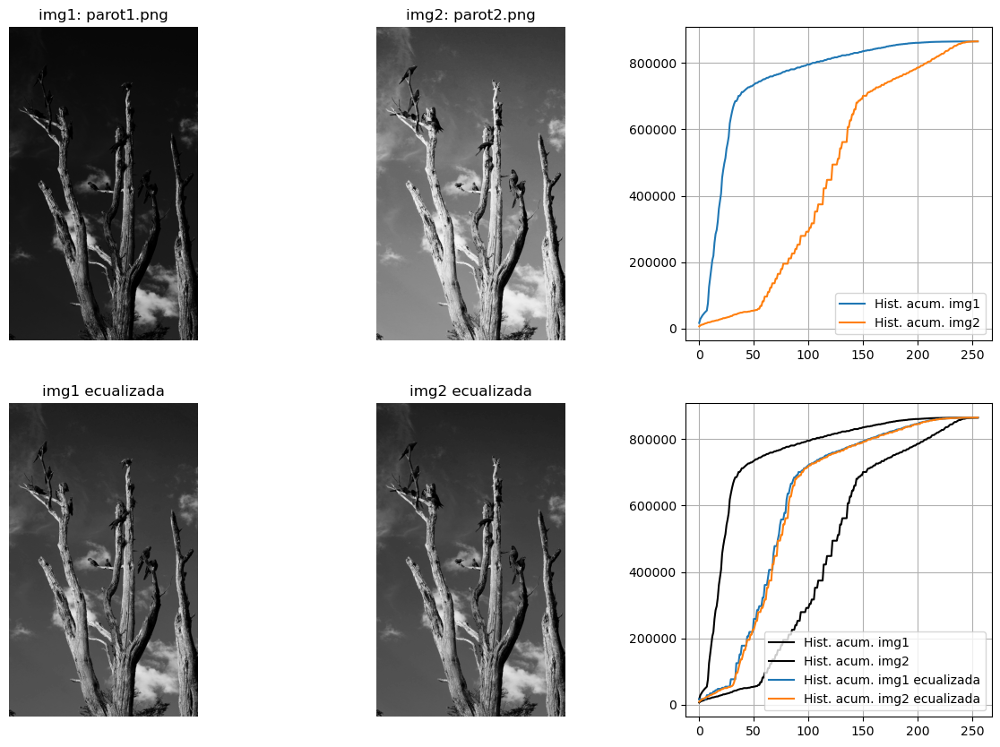

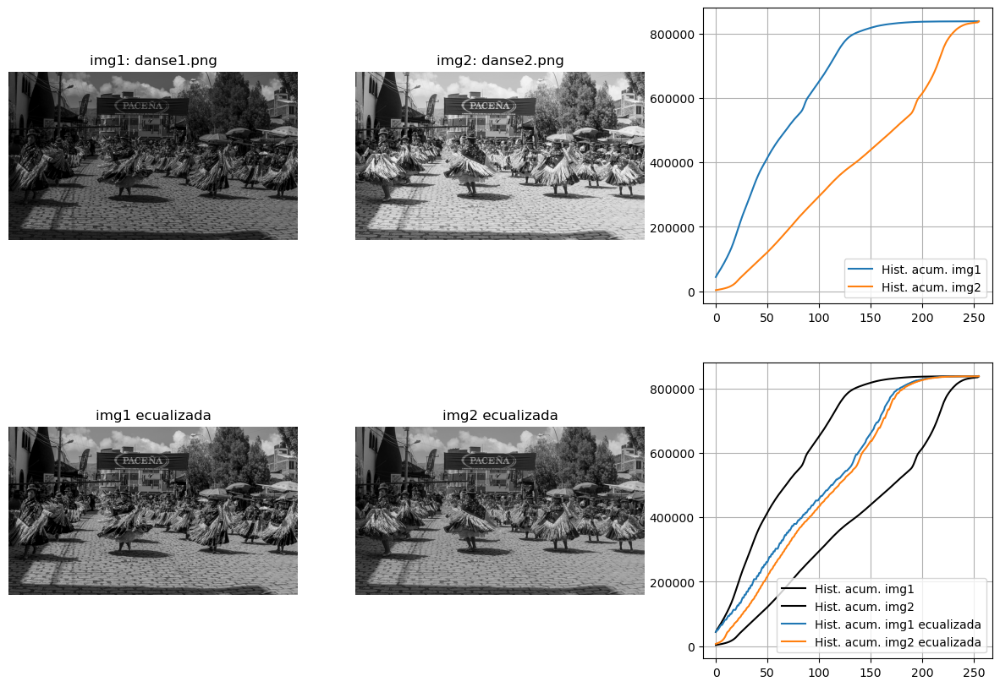

In [10]:
# Graficar imagenes
imagenes = ['parot1.png', 'parot2.png', 'danse1.png', 'danse2.png']

for i in range(2):
    #me voy moviendo de 2 en 2 y leyendo las imagenes
    img1 = imread(f'./imagenes/{imagenes[2*i]}')
    img2 = imread(f'./imagenes/{imagenes[2*i+1]}')
    
    img1_eq, img2_eq = midway_eq(img1, img2)

    fig, ax = plt.subplots(2, 3, figsize=(15, 10))
    ax[0,0].imshow(img1, cmap='gray'), ax[0,0].axis('off'), ax[0,0].set_title(f'img1: {imagenes[2*i]}') 
    ax[0,1].imshow(img2, cmap='gray'), ax[0,1].axis('off'), ax[0,1].set_title(f'img2: {imagenes[2*i+1]}')
    ax[1,0].imshow(img1_eq, cmap='gray'), ax[1,0].axis('off'), ax[1,0].set_title('img1 ecualizada') 
    ax[1,1].imshow(img2_eq, cmap='gray'), ax[1,1].axis('off'), ax[1,1].set_title('img2 ecualizada') 

    # Calcular histogramas acumulados
    bins=256
    H1, bordes1 = histogramaAcumulado(img1, bins)
    H2, bordes2 = histogramaAcumulado(img2, bins)
    H_img1_eq, bordes1eq = histogramaAcumulado(img1_eq, bins)
    H_img2_eq, bordes2eq = histogramaAcumulado(img2_eq, bins)

    # Graficar histogramas acumulados
    # plt.figure()
    ax[0,2].plot(H1, label='Hist. acum. img1')
    ax[0,2].plot(H2, label='Hist. acum. img2')

    ax[1,2].plot(H1, 'k-', label='Hist. acum. img1')
    ax[1,2].plot(H2, 'k-', label='Hist. acum. img2', )
    ax[1,2].plot(H_img1_eq, label='Hist. acum. img1 ecualizada')
    ax[1,2].plot(H_img2_eq,label='Hist. acum. img2 ecualizada')
    ax[0,2].grid()
    ax[0,2].legend()
    ax[1,2].grid()
    ax[1,2].legend()
    # plt.tight_layout()
    plt.show()

Se puede ver como la función realiza el midway histogram para cada imagen de buena manera. Para el segundo par de imágenes, la diferencia entre los histogramas es un poco mayor, de todas maneras esto es esperable ya que la idea es que los histogramas resultantes sean lo más parecidos posible dentro de lo que permite la implementación realizada, pero no exactamente iguales.


##  3) Restauración de imágenes con ruido

**a) A partir de una imagen original, generar imágenes con diferentes niveles de ruido gaussiano (por ejemplo σ=5, 20, 40) y ruido “sal y pimienta” (por ejemplo p=0.1, 0.5, 0.8).**

Imágenes sugeridas: peppers.png, baboon.png, etc (pasadas a gris en caso que estén en colores)   
Otras [imágenes estándar](http://en.wikipedia.org/wiki/Standard_test_image) se pueden encontrar en http://sipi.usc.edu/database/database.php?volume=misc    

In [5]:
def add_gaussian_noise(I, sigma):
    """
    Contaminar imagen con ruido Gaussiano de desviación estándar sigma.

    Args:
        I (ndarray): La imagen de entrada.
        sigma (float): Desviación estándar del ruido.

    Returns:
        J (ndarray): La imagen contaminada con ruido Gaussiano de desviación estándar sigma
    
    """

    alto, ancho = I.shape[:2]
    if I.ndim>2:
        I = I[:,:,0]
    
    J = I.copy()
    for h in range(alto):
        for w in range(ancho):
            ruido = np.random.normal(0,sigma)
            J[h,w] = I[h,w] + ruido
        
    return J

def add_saltpepper_noise(I, p):
    """
    Contaminar imagen con ruido sal y pimienta. Cada pixel tiene probabilidad p de ser contaminado.
    Se asume que, dado un pixel contaminado, la asignación de 0 o 255 (pepper y salt, respectivamente) es equiprobale.

    Args:
        I (ndarray): La imagen de entrada.
        p (float): Probabilidad de que un pixel sea contaminado.

    Returns:
        J (ndarray): La imagen contaminada con ruido sal y pimienta
    
    """
    
    assert p>=0 and p<=1, 'p tiene que tomar un valor entre 0 y 1'
    
    alto, ancho = I.shape[:2]
    if I.ndim>2:
        I = I[:,:,0]
        
    J = I.copy()
    for h in range(alto):
        for w in range(ancho):
            modifico_pixel = np.random.binomial(1,p)
            if modifico_pixel!=0:
                salt_o_peper = np.random.randint(0,2)
                if salt_o_peper>0.5:
                    J[h,w]=0
                else:
                    J[h,w]=255
    
    return J

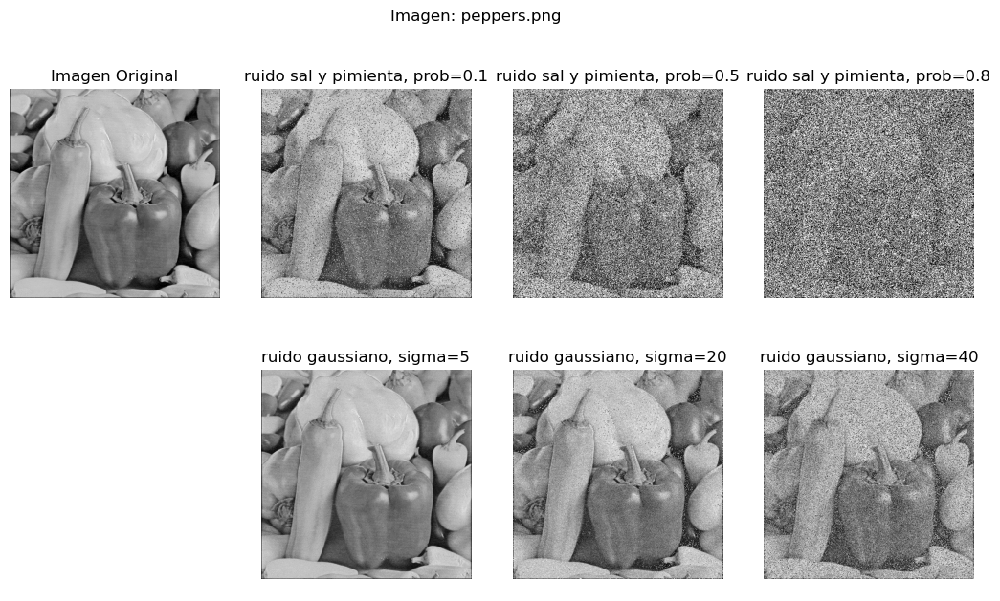

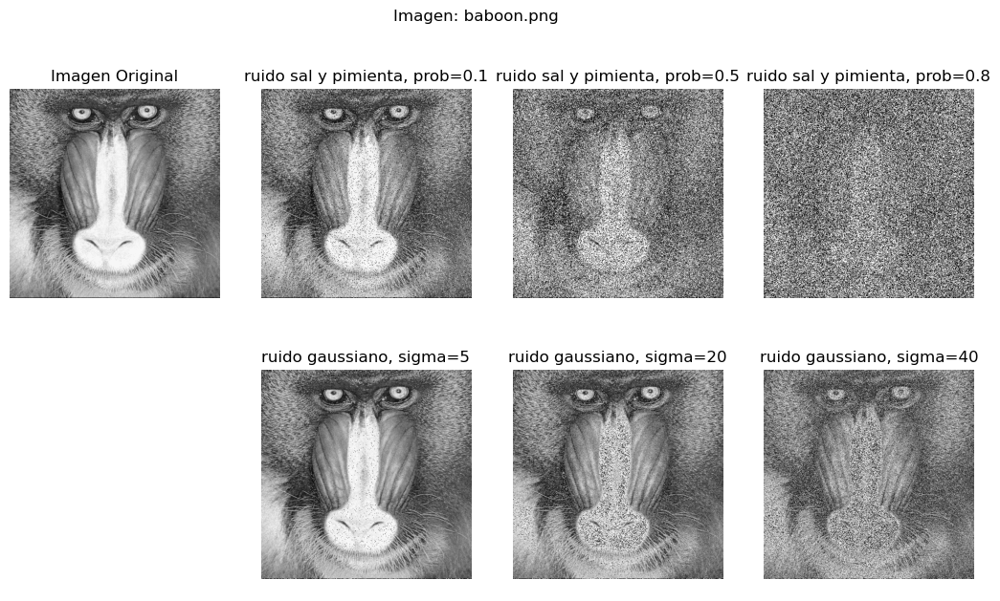

In [6]:
imagenes = ['peppers.png', 'baboon.png']
sigmas = [5, 20, 40]
probabilidades = [0.1, 0.5, 0.8]

for str in imagenes:
    
    I = imread(f'imagenes/{str}')
    if I.ndim>2:
        I = I[:,:,0]
        
    titulo = f'Imagen: {str}'
    
    fig, ax = plt.subplots(2, 4, figsize=(13,7))
    ax[0,0].imshow(I, cmap='gray')
    ax[0,0].set_title('Imagen Original')
    ax[0,0].axis("off")
    ax[1,0].axis("off")
    
    i = 0
    for sigma, prob in zip(sigmas, probabilidades):
        syp = add_saltpepper_noise(I, prob)
        ax[0, i+1].imshow(syp, cmap='gray')
        ax[0, i+1].set_title(f'ruido sal y pimienta, prob={prob}')
        ax[0, i+1].axis('off')

        gauss = add_gaussian_noise(I, sigma)
        ax[1, i+1].imshow(gauss, cmap='gray')
        ax[1, i+1].set_title(f'ruido gaussiano, sigma={sigma}')
        ax[1, i+1].axis('off')
        i+=1
    
    
    fig.suptitle(titulo)
    plt.show()

**b) Procesar las imágenes de (a) con**
* filtros de media de diverso tamaño (implementar)
* filtros de mediana de diverso tamaño (implementar)
* Non local means (usar implementación de OpenCV y/o de scikit-image). 

**Para Non local means: explicar en qué se basa el algoritmo y sus parámetros principales.**

In [7]:
def meanFilter(I, filterSize, pad='edge'):
    """filtra la imagen realizando el promedio en una ventana de tamaño filterSize (tupla, ambos numeros tienen que ser impares)

    Args:
        I (_type_): imagen a filtrar
        filterSize (_type_): tupla (alto_filtro, ancho_filtro), ambos valores tienen que ser impares
        pad (str, optional): como rellenar la imagen, tiene que ser algun parametro aceptado por np.pad. 
                            Algunos ejemplos: 'edge', 'constant', 'symmetric'  o 'mean'. Defaults to 'edge'.

    Returns:
        _type_: imagen filtrada de igual tamaño que la original
    """
    
    alto, ancho = I.shape[:2]
    alto_filtro, ancho_filtro = filterSize
    
    if I.ndim>2:
        I = I[:,:,0]
    
    assert (alto_filtro % 2 ==1) and (ancho_filtro % 2 ==1), 'ambos valores del tamaño del filtro tienen que ser impares'
    
    bordes_alto = int((alto_filtro - 1) /2) # cantidad de filas con las que tengo problema en el borde
    bordes_ancho = int((ancho_filtro - 1) /2) # cantidad de filas con las que tengo problema en el borde
    
    I_padded = np.pad(I, [(bordes_alto, bordes_alto),(bordes_ancho, bordes_ancho)], mode=pad)
    
    J = np.zeros_like(I)
    
    for h in range(alto):
        for w in range(ancho):
            promedio = 0 #para cada uno de los pixeles
            division = 0
            for x in range(-bordes_ancho, bordes_ancho+1):
                for y in range(-bordes_alto, bordes_alto+1):
                    promedio += I_padded[h+y, w+x]
                    division += 1
            promedio = promedio/division
            J[h,w] = promedio
            
    return J


def medianFilter(I, filterSize, pad='edge'):
    """filtra la imagen quedandose con la mediana de la ventana de tamaño filterSize (tupla, ambos numeros tienen que ser impares), 
    
    Args:
        I (_type_): imagen a filtrar
        filterSize (_type_): tupla (alto_filtro, ancho_filtro), ambos valores tienen que ser impares
        pad (str, optional): como rellenar la imagen, tiene que ser algun parametro aceptado por np.pad. 
                            Algunos ejemplos: 'edge', 'constant', 'symmetric'  o 'mean'. Defaults to 'edge'.

    Returns:
        _type_: imagen filtrada
    """
    
    alto, ancho = I.shape[:2]
    alto_filtro, ancho_filtro = filterSize
    
    if I.ndim>2:
        I = I[:,:,0]
    
    assert (alto_filtro % 2 ==1) and (ancho_filtro % 2 ==1), 'ambos valores del tamaño del filtro tienen que ser impares'
    
    bordes_alto = int((alto_filtro - 1) /2) # cantidad de filas con las que tengo problema en el borde
    bordes_ancho = int((ancho_filtro - 1) /2) # cantidad de filas con las que tengo problema en el borde
    
    I_padded = np.pad(I, [(bordes_alto, bordes_alto),(bordes_ancho, bordes_ancho)], mode=pad)
    
    mediano = ((alto_filtro * ancho_filtro) // 2) +1 # indice medio de la lista, el valor con el que me voy a quedar
    
    J = np.zeros_like(I)
    
    for h in range(alto):
        for w in range(ancho):
            lista = []
            for x in range(-bordes_ancho, bordes_ancho+1):
                for y in range(-bordes_alto, bordes_alto+1):
                    lista.append(I_padded[h+y, w+x])
                    
            lista.sort()
            J[h,w] = lista[mediano]
        
        
    return J

_Respuesta NLM:_

Non Local Means es un algoritmo que busca reducir el ruido pero no lo hace de manera local como los filtros media y mediana (que trabajan en una vecindad del pixel en el que operan). Sino que toma grupos de pixeles que esten juntos y busca en otras zonas de la imagen otro grupo de pixeles (del mismo tamaño) que sean parecidos, generando varios clusters, y sobre cada uno de esos clusters realiza el promedio para reducir el ruido.

Sus parámetros principales son:

> patch_size, tamaño de los patches que se usan para reducir el ruido.

> patch_distance, máxima distancia en pixeles a la cual se va a buscar patches parecidos.

> h, que indica que tan permisivo se es en aceptar los patches, un h alto resulta en una imagen mas suave (imagen mas borrosa).

> sigma, si se conoce o se estima la desviacion estandar del ruido se puede pasar como parámetro para recuperar mejor la imagen original.


**c) Cuantificar la reducción de ruido utilizando medidas adecuadas (PSNR, RMSE).**  
Indicar cuáles de los algoritmos son adecuados para cada tipo de ruido.

Las métricas a usar pueden encontrarse en [skimage.metrics ](https://scikit-image.org/docs/stable/api/skimage.metrics.html)

In [34]:
from skimage.metrics import peak_signal_noise_ratio, mean_squared_error
from skimage.restoration import denoise_nl_means, estimate_sigma

I = imread(f'imagenes/peppers.png')
if I.ndim>2:
    I = I[:,:,0]

gaus5 = add_gaussian_noise(I, 5)
gaus20 = add_gaussian_noise(I, 20)
gaus40 = add_gaussian_noise(I, 50)

syp1 = add_saltpepper_noise(I, 0.1)
syp5 = add_saltpepper_noise(I, 0.5)
syp8 = add_saltpepper_noise(I, 0.8)


imagenes = [gaus5, gaus20, gaus40, syp1, syp5, syp8]

nombres = ['ruido gaussiano, sigma=5', 'ruido gaussiano, sigma=20', 'ruido gaussiano, sigma=40',
           'ruido sal y pimienta, p=0.1', 'ruido sal y pimienta, p=0.5', 'ruido sal y pimienta, p=0.8']

hs= [0.75, 1.2, 1.3, 0.9, 1.1, 1.3]
patch_distances = [3, 4, 4, 3, 4, 5]


C:\Users\juanm\AppData\Local\Temp\ipykernel_19364\448981243.py:43: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_nlmeans = peak_signal_noise_ratio(I, nlmeans*255)


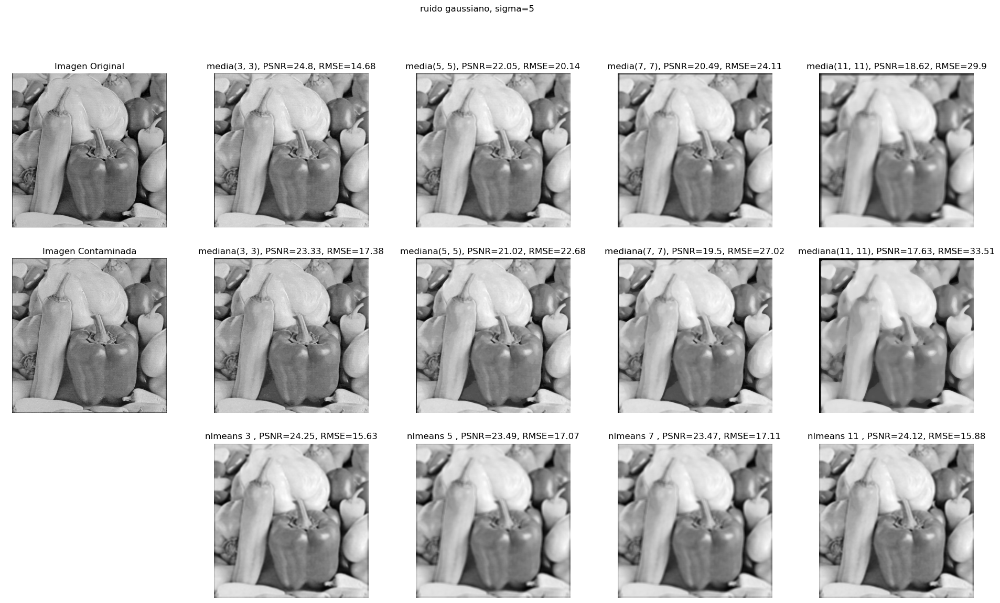

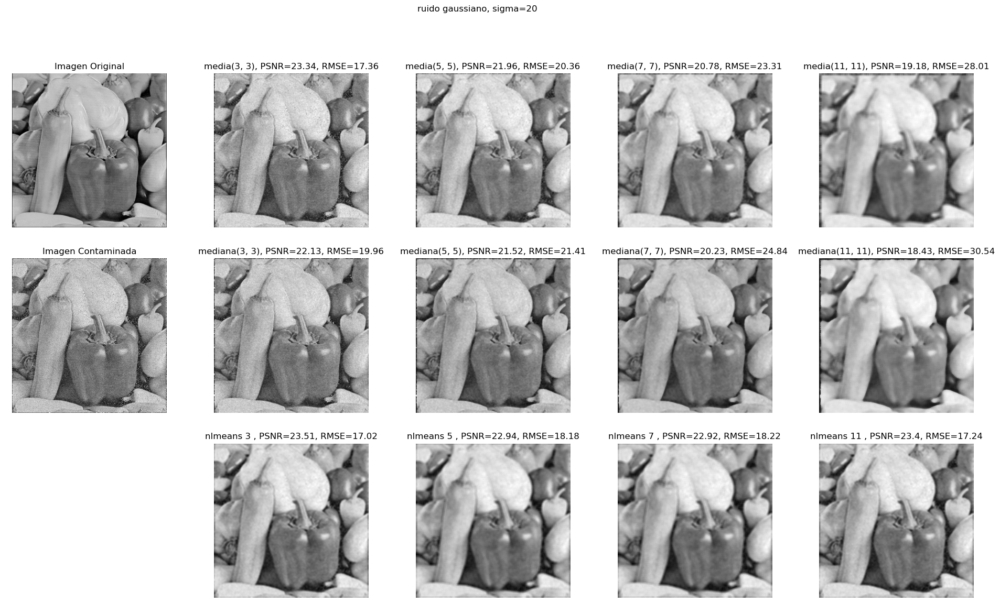

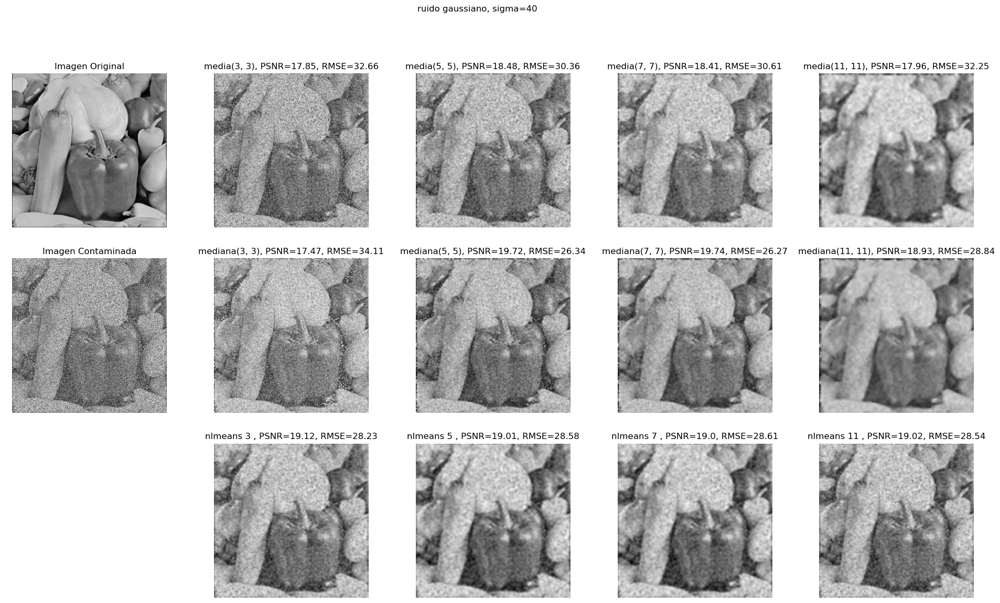

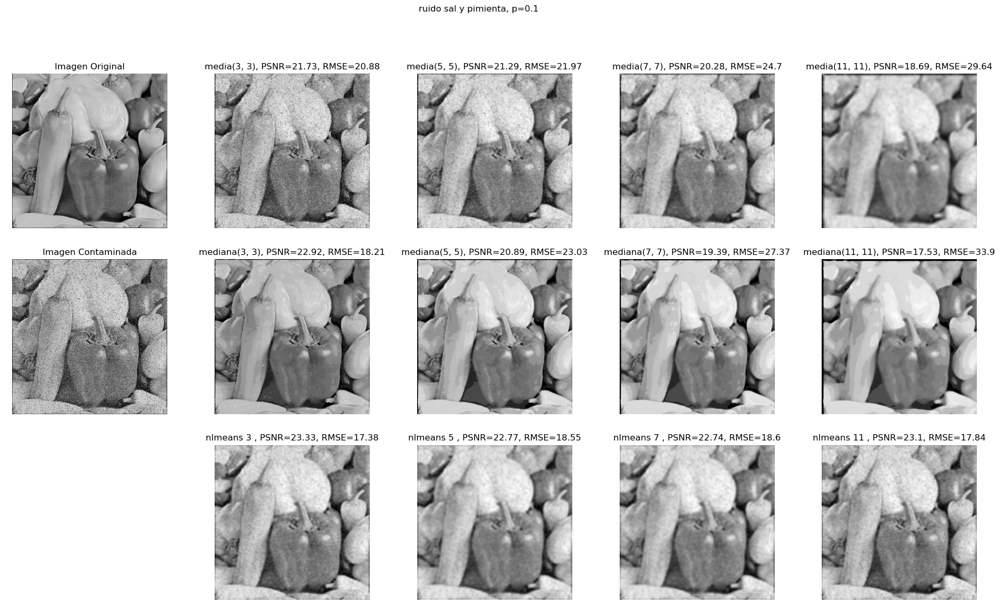

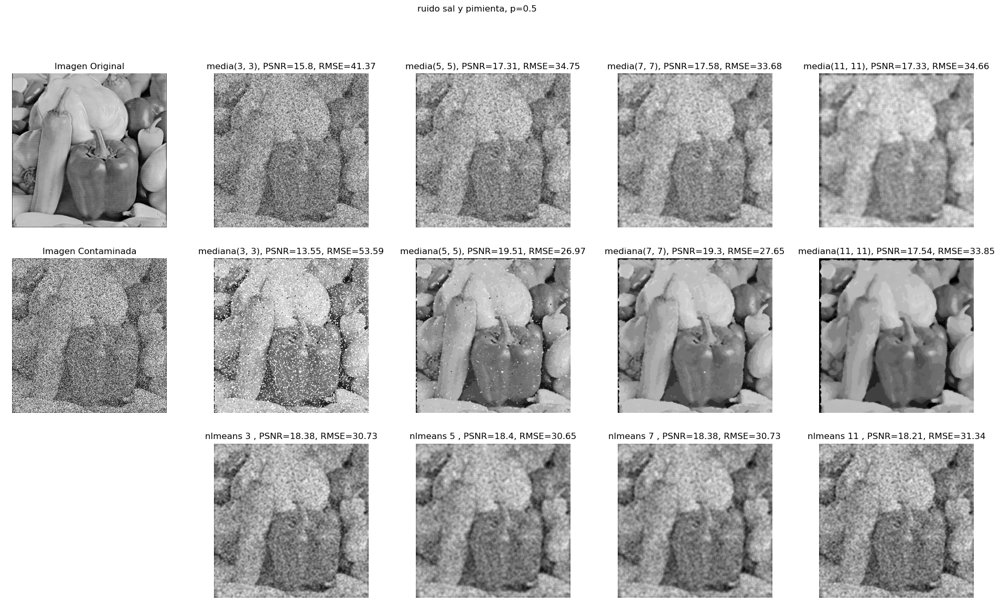

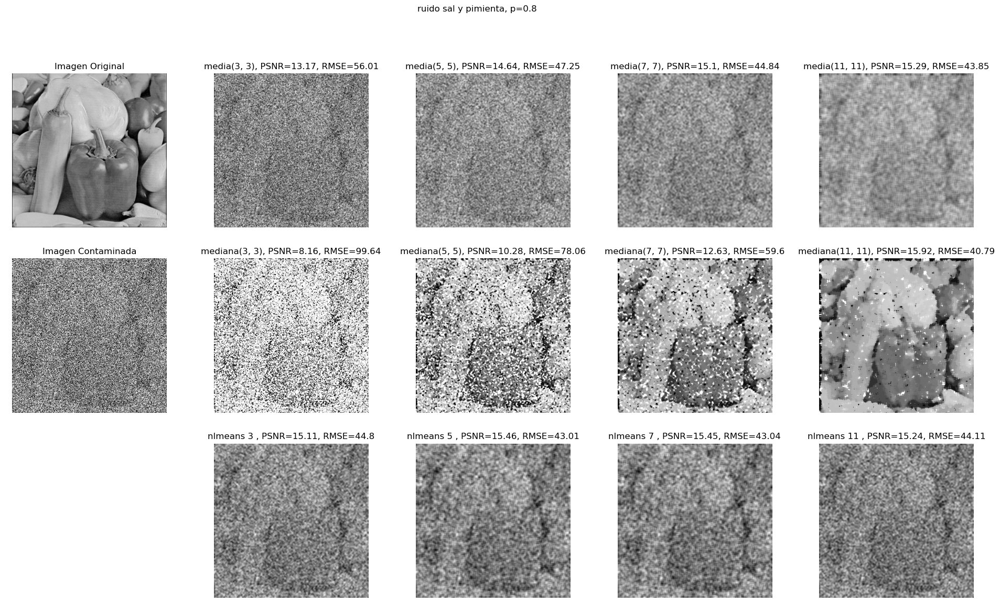

In [37]:
tamanios_filtros = [(3,3), (5,5), (7,7), (11,11)]

for im_contaminada, titulo  in zip(imagenes, nombres):
    # para cada imagen contaminada que quiero analizar hago lo siguiente:

    fig, ax = plt.subplots(3, len(tamanios_filtros)+1, figsize=(24,13))
    # despliego la imagen original y la contaminada
    ax[0,0].imshow(I, cmap='gray'), ax[0,0].set_title('Imagen Original')
    ax[1,0].imshow(im_contaminada, cmap='gray'), ax[1,0].set_title('Imagen Contaminada')
    
    
    for i, filtro in enumerate(tamanios_filtros):
        #como para todos los tamaños quiero hacer lo mismo, itero en ellos y voy desplegando los resultados
        
        # aplico el filtro de media
        media = meanFilter(im_contaminada, filtro)
        # calculo las metricas asociadas a la reconstruccion de la imagen
        psnr_media = peak_signal_noise_ratio(I, media)
        rmse_media = np.sqrt(mean_squared_error(I, media))
        # despliego la reconstruccion y las metricas
        ax[0, i+1].imshow(media, cmap='gray'), ax[0, i+1].set_title(f'media{filtro}, PSNR={round(psnr_media,2)}, RMSE={round(rmse_media,2)}', fontsize=12)
        
        
        # aplico el filtro de mediana
        mediana = medianFilter(im_contaminada, filtro)
        # calculo las metricas asociadas a la reconstruccion de la imagen
        psnr_mediana = peak_signal_noise_ratio(I, mediana)
        rmse_mediana = np.sqrt(mean_squared_error(I, mediana))
        # despliego la reconstruccion y las metricas
        ax[1, i+1].imshow(mediana, cmap='gray'), ax[1, i+1].set_title(f'mediana{filtro}, PSNR={round(psnr_mediana,2)}, RMSE={round(rmse_mediana,2)}', fontsize=12)
            
        
        # aplico el filtro non local means
        
        #pasarle el sigma si el ruido es gaussiano y h = sigma * (entre 0,8 y 1,15)
        sigma_est = estimate_sigma(im_contaminada)
        nlmeans = denoise_nl_means(im_contaminada, patch_size = filtro[0], fast_mode=True,
                                   patch_distance = patch_distances[i] , h = hs[i])
        #el resultado de esta funcion esta entre 0 y 1
    
            
        # calculo las metricas asociadas a la reconstruccion de la imagen
        psnr_nlmeans = peak_signal_noise_ratio(I, nlmeans*255)
        rmse_nlmeans = np.sqrt(mean_squared_error(I, nlmeans*255))
        # despliego la reconstruccion y las metricas
        ax[2, i+1].imshow(nlmeans, cmap='gray'), ax[2, i+1].set_title(f'nlmeans {filtro[0]} , PSNR={round(psnr_nlmeans,2)}, RMSE={round(rmse_nlmeans,2)}', fontsize=12)
    

    for i, x in enumerate(ax.ravel()):
        # x.set_title(titles[i])
        x.axis("off")
    
    fig.suptitle(titulo)
    plt.show()

Para los filtros de media y mediana se varió unicamente el tamaño del filtro, ploteando cada uno de estos resultados. Para non local means, se probaron varios parametros h y patch_distance y se seleccionaron los óptimos para cada tipo e intensidad de ruido, luego se probó con esos parámetros y con distinto patch_size, resultando en lo que se muestra en las imagenes.

### Considerando unicamente como se implementa la adición de cada ruido y cada algoritmo de restauración:

El ruido gaussiano sigue una distribución tipo campana que suma valores centrados a 0 a la imagen original, por lo que la imagen contaminada resulta en píxeles que estan en torno su valor original, distribuidos hacia valores ligeramente mayores y menores. Por lo tanto, tiene sentido que el filtro de media sea el que mejor funcione en este caso, ya que realiza el promedio de todos los pixeles que caen dentro de la ventana.
Para tamaños de filtros cada vez mayores, la ventana dentro de la cual se promedia es cada vez mas grande, por lo que se promedia entre más numeros y la imagen queda más suavizada.

Por otro lado, el ruido sal y pimienta lleva los pixeles a 0 o a 255, alejandolos completamente de su valor original, en este caso no se recupera de buena manera la informacion realizando un promedio. Tiene sentido utilizar el filtro de mediana, que se queda con la mediana de la ventana, ya que voy a tener pixeles muy por encima y muy por abajo de su valor original. Como se tiene la misma probabilidad de llevar los pixeles a 0 o a 255, quedándome con la mediana de la ventana es probable que tome un pixel cuyo valor no haya sido modificado y, como estoy trabajando en una vecindad no muy grande, pueda de esta manera recuperar aproximadamente el valor original del pixel que me interesa.
Al igual que en el caso anterior, cuando más grande es el radio del filtro mayor es el suavizado que se le aplica a la imágen.


No tengo claro en cual de los casos debería funcionar de mejor manera el filtro non local means, pero creo que el ruido gaussiano distorsiona menos lo parecidos que pueden llegar a ser los patches con los que trabaja nlmeans, dedo a que todos pixeles quedan en un entorno cercano a su valor original, mientras que el ruido sal y pimienta modifica bruscamente el valor de algunos pixeles y creo que esto puede dificultar más el encontrar y relacionar patches originalmente parecidos entre si.



### Luego de la implementación y visualización de las imágenes restauradas y sus métricas con respecto a la imagen original:

Se confirma la intuición mencionada anteriormente, el filtro mediana es el que mejor recupera la imagen contaminada por amplia diferencia visual y numerica, como se puede apreciar en la imagen. Este tipo de ruido parece destruir más contundentemente la información de la imagen y hace que esa información sea más dificil de recuperar. Para mi sorpresa, con el ruido gaussiano el filtro mediana tiene un rendimiento más que aceptable, siendo comparable con los otros dos filtros y con sigma=40 siendo el que llega a obtener el mejor resultado


Tanto el filtro de media como nlmeans eliminan de muy buena manera el ruido gaussiano de una imagen sin perder mucha información, para cada intensidad de ruido gaussiano se obtienen métricas muy similares. Ninguno de estos dos filtros funciona bien con el ruido sal y pimienta (salvo en el caso con p=0.1 donde su rendimiento en números es similar al del filtro mediana aunque visualmente la reconstrucción es peor).


Es importante mencionar que los filtros funcionan hasta cierto punto, cuando la intensidad del ruido que agrego es muy grande, se pierde demasiada información de la imagen y ya hay parte de esa información que no se puede recuperar. Esto se puede ver para los últimos ejemplos de cada tipo de ruido (en el caso del sal y pimienta, cuando p=0.8 y en el caso del ruido gaussiano, cuando sigma=40) donde la imagen mejor reconstruida ya no es para nada similar a la original.

**Nota:** En caso que lo deseen, la parte de cuantificación puede realizarse en Fiji mediante el plugin SNR como se muestra en el video de Restauración.  
Para eso, se puede guardar las imágenes originales, ruidosas y restauradas generadas en el notebook y luego procesarlas con Fiji.  
El plugin se encuentra disponible en http://bigwww.epfl.ch/sage/soft/snr/.
También se encuentra como ejemplo el macro *Macro_noise.ijm* para generar las imagenes ruidosas y la restauración.

## Transformada DFT

## 4) Movimiento lineal uniforme 

**a) Ver PSF y MTF del movimiento lineal uniforme (se provee una función que calcula la PSF a partir del largo y el ángulo del movimiento)**    

Para un cierto movimiento lineal, mostrar PSF y MTF. Analizar qué forma tiene la MTF.  

Aplicar el movimiento sobre una imagen y mostrar las imágenes original y degradada y sus transformadas.

In [12]:
from skimage import transform
import numpy as np

def motionPSF(largo=9,angulo_en_grados=0, sz=65):
    # Se genera una imagen cuadrada de lado sz y se pinta una linea horizontal 
    # en el medio de la imagen de tamaño igual al largo
    f = np.zeros((sz,sz)) 
    f[sz // 2, sz // 2 - largo//2 : sz // 2 + largo//2 + 1]=1  # "//" hace una división entera  
    # Luego se rota el angulo especificado
    f = transform.rotate(f,angulo_en_grados)
    # Finalmente se normaliza
    f = f/np.sum(f)
    return f

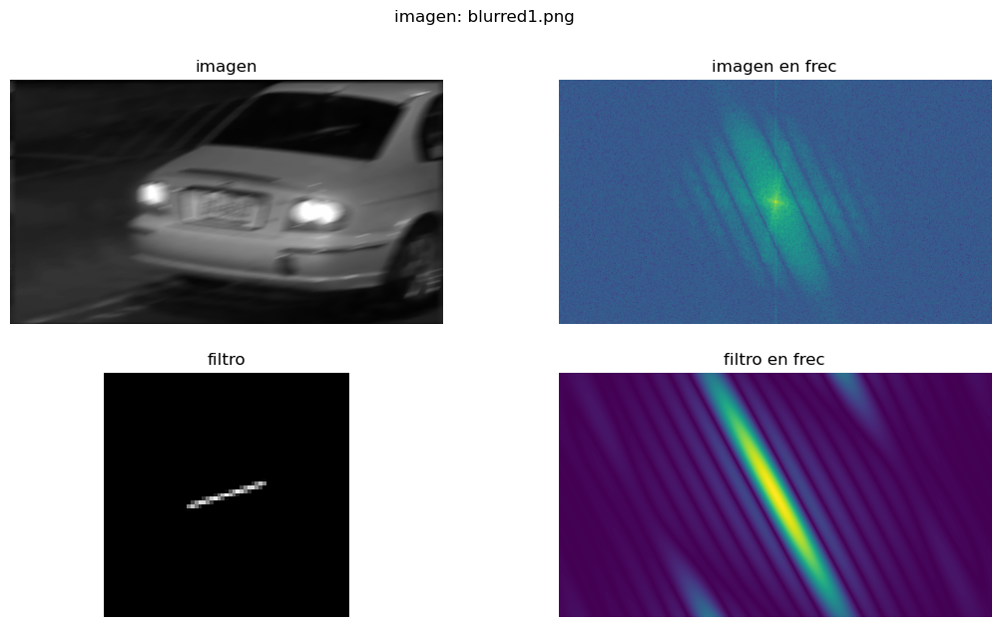

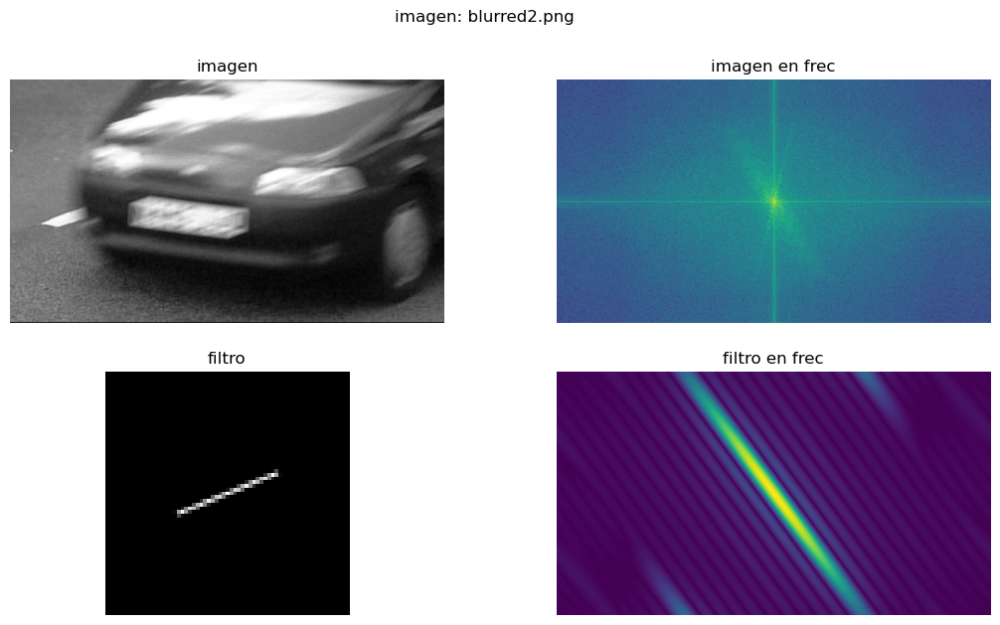

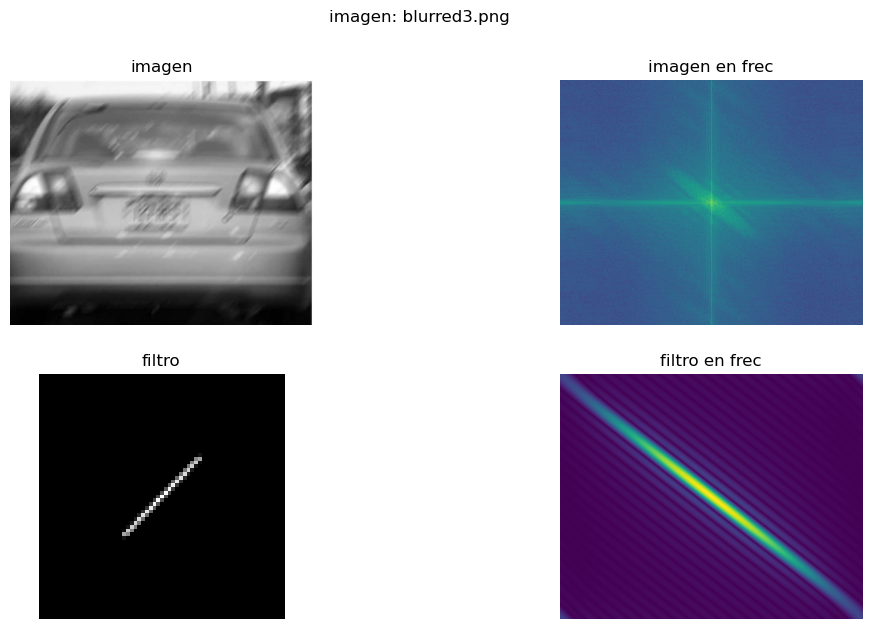

In [13]:
from scipy.fftpack import fft2, ifft2, fftshift
imagenes = ['blurred1.png', 'blurred2.png', 'blurred3.png']
# de analizar las imagenes en FIJI se obtuvieron los siguientes pares (largo, angulo)
largos_y_angulos = [(20, 17), (28, 22.5), (29, 46)]



for str, info in zip(imagenes, largos_y_angulos):
    # se carga la imagen
    im = cv2.imread(f'imagenes/{str}')
    im_gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    
    # se transforma la imagen
    im_f = fft2(im_gray)
    shape_im_f = im_f.shape
    
    # se crea el filtro con la info obtenida previamente en fiji
    filtro =  motionPSF(info[0], info[1])
    
    # se obtiene la mtf
    mtf = fft2(filtro, shape=shape_im_f)

    # se plotea todo
    fig, ax = plt.subplots(2, 2, figsize=(13,7))
    ax[0,0].imshow(im_gray, cmap='gray')
    ax[0,1].imshow(np.log10(1 + np.abs(fftshift(im_f))))
    ax[1,0].imshow(filtro, cmap='gray')
    ax[1,1].imshow(np.abs(fftshift(mtf)))
   
    titles = ["imagen", "imagen en frec", "filtro", "filtro en frec", "deblurr", "deblurr en frec"]
    for i, a in enumerate(ax.ravel()):
        a.set_title(titles[i])
        a.axis("off")
        
    fig.suptitle(f'imagen: {str}')
    plt.show()
    
    


Se puede ver como las MTF estan compuestas por líneas en dirección perpendicular a PSF. Esto tiene sentido ya que la PSF es una línea que se extiende en una dirección específica y la transformada de Fourier de esto (es decir, las sinusoides que se suman para crear esa línea) tienen que distribuirse en su mayoría en direcciones perpendiculares a la línea de la PSF. 

La PSF tambien puede considerarse como un escalón, lo que hace que la MTF se pueda interpretar como un sinc, esto coincide con lo que se observa en la imagen.

**b) Se busca hacer visible el número de matrícula en las imágenes blurred1.png, blurred2.png, blurred3.png.  
Intente restaurar las imágenes utilizando las siguientes técnicas:**

* Filtrado inverso (implementar)   
* Filtrado pseudo inverso (implementar)    
* Filtrado de Wiener (usar la función “wiener” del paquete skimage.restoration con diversos parámetros)
* Probar un método iterativo de deconvolución (p.ej Richardson-Lucy) con un paquete de scikit-image o Deconvolution-Lab en Fiji

In [16]:

from skimage.restoration import wiener, richardson_lucy

# Filtrado inverso y pseudo inverso
def filtroInversoYPseudo(img, largo, angulo, sz, cte=None):
    
    # se transforma la imagen
    im_f = fft2(img)
    shape_im_f = im_f.shape
    
    # se crea el filtro con la info obtenida previamente en fiji
    filtro =  motionPSF(largo, angulo, sz)
    
    # se obtiene la mtf
    mtf = fft2(filtro, shape=shape_im_f)
    
    # se invierte el filtro
    if cte==None:
        G = 1/mtf
    else:
        G = 1/(mtf + cte)
        
    #  multiplico en frecuencia y hago la ifft
    deblurr_f = G * im_f
    deblurr = np.abs(ifft2(deblurr_f))
    
    return deblurr


def filtroWiener(img, largo, angulo, sz, bal):
    
    # Se calcula la PSF dados los parametros    
    psf_img = motionPSF(largo, angulo, sz)

    # Se aplica el filtro
    y = wiener(img, psf_img, balance=bal, clip=False)
    
    return y



def filtroRichardsonLucy(img, largo, angulo, sz, num_iter):
    
    # Se calcula la PSF dados los parametros    
    psf_img = motionPSF(largo, angulo, sz)

    # Se aplica el filtro
    y = richardson_lucy(img, psf_img, num_iter)
    
    return y

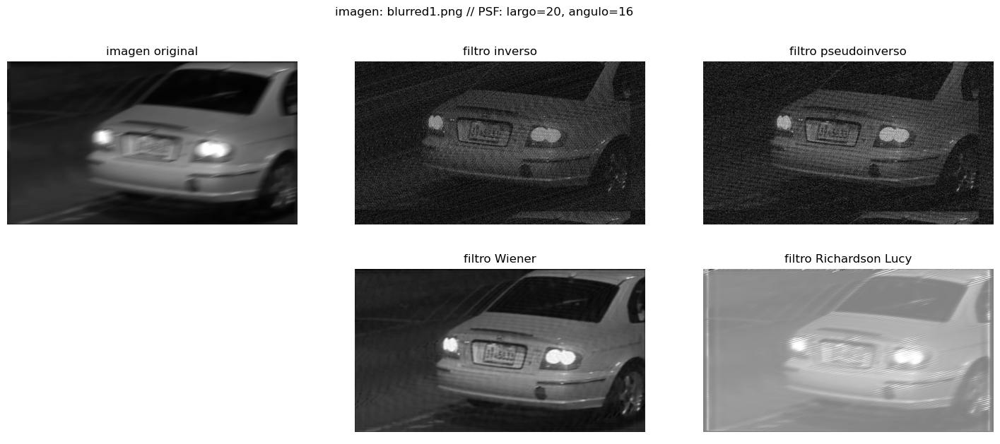

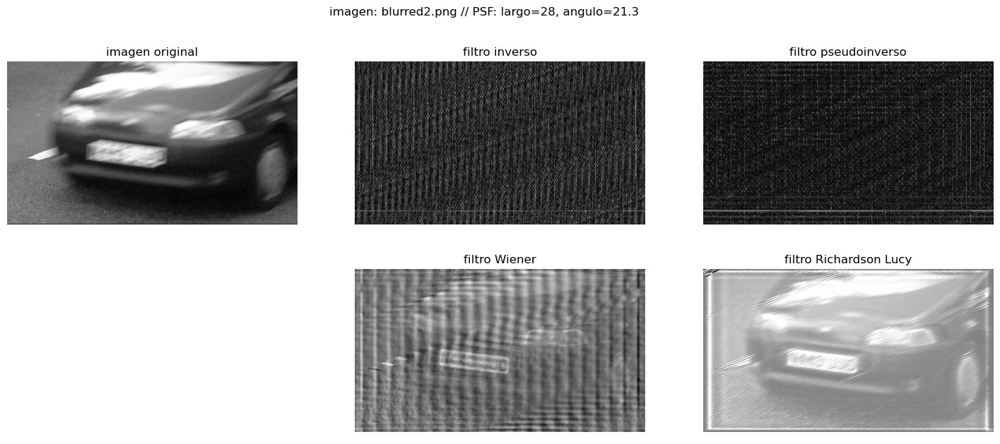

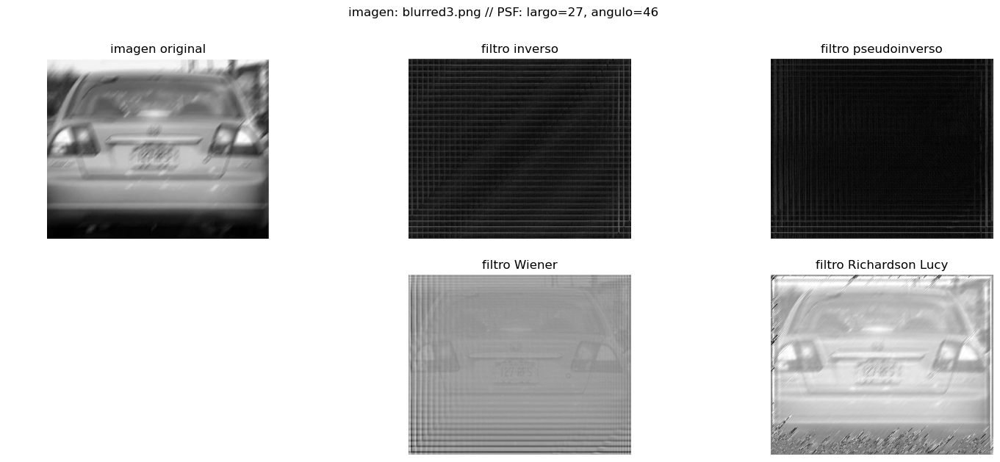

In [19]:
from scipy.fftpack import fft2, ifft2, fftshift

imagenes = ['blurred1.png', 'blurred2.png', 'blurred3.png']
largos_y_angulos = [(20, 16), (28, 21.3), (27, 46)]


for str, info in zip(imagenes, largos_y_angulos):
    # se carga la imagen
    im = cv2.imread(f'imagenes/{str}')
    im_gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    
    # se llama a los filtros con la ifnormacion del largo y angulo de la psf correspondientes
    filtro_inverso = filtroInversoYPseudo(im_gray, info[0], info[1], sz=64)
    filtro_pseudoinverso = filtroInversoYPseudo(im_gray, info[0], info[1], sz=64, cte=0.01)
    filtro_weiner = filtroWiener(im_gray/np.max(im_gray), info[0], info[1], sz=64, bal=0.01)
    filtro_rich_lucy = filtroRichardsonLucy(im_gray/np.max(im_gray), info[0], info[1], sz=64, num_iter=10)
    
    #se muestran los resultados
    fig, ax = plt.subplots(2, 3, figsize=(18,7))
    
    ax[0,0].imshow(im_gray, cmap='gray')
    ax[0,1].imshow(filtro_inverso, cmap='gray')
    ax[0,2].imshow(filtro_pseudoinverso, cmap='gray')
    ax[1,1].imshow(filtro_weiner, cmap='gray')
    ax[1,2].imshow(filtro_rich_lucy, cmap='gray')


    titles = ["imagen original", "filtro inverso", "filtro pseudoinverso"," ", "filtro Wiener", "filtro Richardson Lucy"]
    for i, a in enumerate(ax.ravel()):
        a.set_title(titles[i])
        a.axis("off")
        
    fig.suptitle(f'imagen: {str} // PSF: largo={info[0]}, angulo={info[1]}')
    plt.show()




Se tomaron medidas sobre las imagenes en fiji y se obtuvieron posibles largos y angulos para la psf, luego se iteró sobre numeros cercanos a estas medidas tomadas, y lo que se muestra finalmente en el notebook son los mejores resultados para cada imagen.

Para la imagen 'blurred1.png' funcionan muy bien tanto el filtro inverso como el pseudo inverso, donde en ambos casos se puede apreciar que la matricula del auto es 395833, el filtro de weiner tambien funciona de buena manera y la matricula se lee perfectamente, el filtro de Richarson-Lucy muestra una imagen que reduce el movimiento del auto pero la matricula no se llega a leer.

Para las imagenes 'blurred2.png' y 'blurred3.png', los filtros inverso y pseudoinverso no logran mostrar nada identificable, esto fue asi para todos los valores con los que se probaron. Los filtro de weiner y Richarson-Lucy funcionan mejor, aunque para las dos imagenes ambos filtros se ven bastante borrosos, lo que igualmente no impide leer las matriculas que era el objetivo.
Para 'blurred3.png' se puede leer la matricula 127RFS perfectamente con los dos filtros. Para la imagen 'blurred2.png' intenté con muchos parametros distintos pero lo mas cercano que estuve a obtener algo legible es lo que se muestra en el notebook, leyendo una parte de la matricula en la imagen filtrada con el filtro de weiner y la otra parte con el de Richarson-Lucy parece ser algo parecido a N440JJO. 



## 5) Eliminación de ruido estructurado 

Las imágenes “radiografía1.png“y “radiografía2.png”  se encuentran contaminadas con ruido con cierta estructura.    

a) Visualizar las imágenes junto con sus transformadas DFT. Determinar las características del ruido.

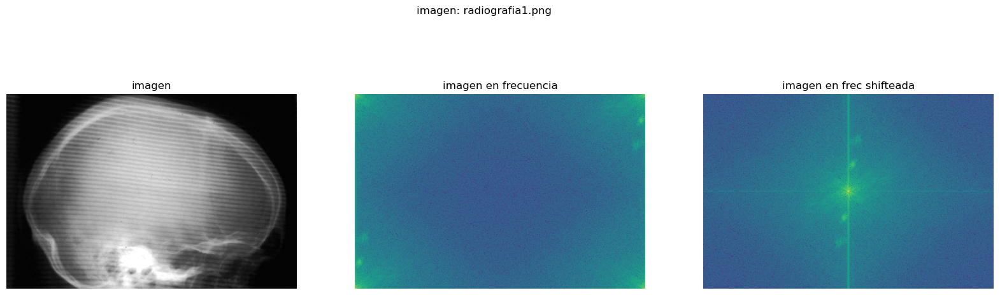

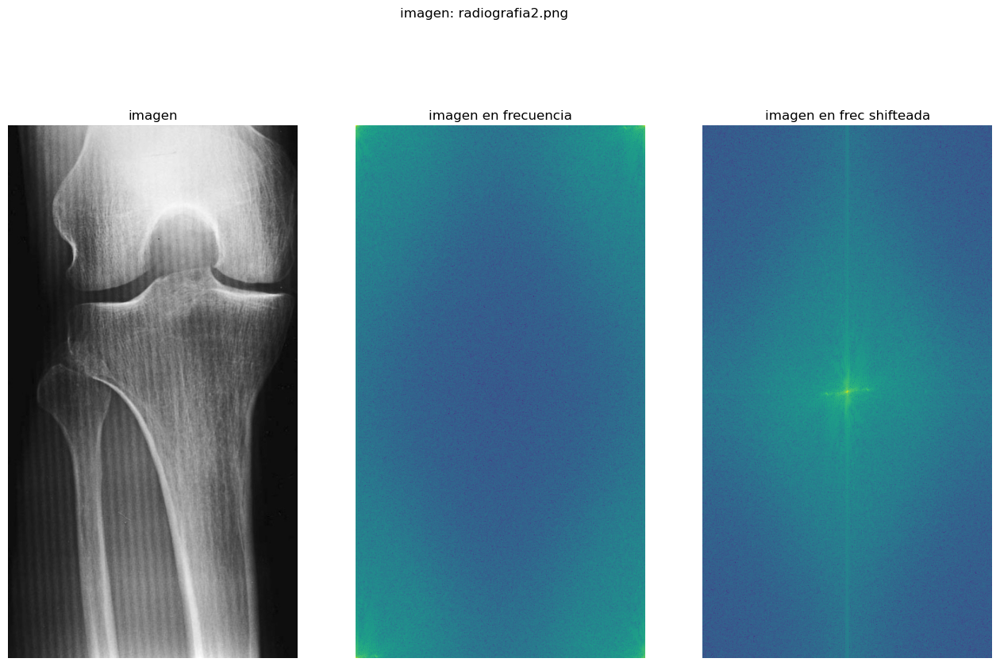

In [44]:
imagenes = ["radiografia1.png",  "radiografia2.png"]
tamanios = [(20,6), (16,10)]

for str, tamanio in zip(imagenes, tamanios):
    # se carga la imagen
    im = cv2.imread(f'imagenes/{str}')
    im_gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    # print(im_gray.shape)
    
    # se transforma la imagen
    im_f = np.abs(fft2(im_gray))
    im_f_shift = np.abs(fftshift(fft2(im_gray)))
    alto, ancho = im_f.shape
    
    fig, ax = plt.subplots(1, 3, figsize = tamanio)
    
    ax[0].imshow(im_gray, cmap='gray')
    ax[1].imshow(np.log10(1+im_f))
    ax[2].imshow(np.log10(1+im_f_shift))
    
    titles = ["imagen", "imagen en frecuencia", "imagen en frec shifteada"]
    
    for i, a in enumerate(ax.ravel()):
        a.set_title(titles[i])
        a.axis("off")
        
    fig.suptitle(f'imagen: {str}')
    plt.show()
    
    # radiografia 1
    # 259 123
    # 268 80
    # 243 215
    # 238 256
    
    
    # radiografia 2
    #276 442
    #208 450
    

El ruido de cada imagen son rayas "blancas y negras" que van aclarando y oscureciendo la imagen y se van repitiendo paralelamente en la misma direccion, parecen corresponder a una sinusoide que se suma sobre la imagen original, lo cual al verificar el espectro de la imagen se confirma ya que aparecen unos puntos con mucha intensidad, cada uno de estos puntos (2 pares de puntos simétricos en la primer imagen y 1 par simétrico en la segunda) corresponde a un conjunto de sinusoides muy similares, que explican coherentemente lo mencionado. 

b) Para cada una de ellas diseñar un filtro que permita eliminar la interferencia tanto como sea posible. Los filtros a utilizar serán de la forma    

$$ H(u,v) = \prod_{i=1}^N \left( 1 - \exp \left( \frac{-(u-{u_0}_i)^2 - (v-{v_0}_i)^2}{\sigma_i^2} \right) \right) $$


Explicar el procedimiento utilizado para diseñar el filtro indicando los valores de los parámetros elegidos. 

Implementar una función que, dadas las componentes de frecuencia a filtrar, devuelva el filtro H.


In [39]:
def filtro_para_ruido_estructurado(im_frec, u0s, v0s, sigmas):
    
    alto, ancho = im_frec.shape[:2]
    ret = np.ones_like(im_frec)
    I = np.ones_like(im_frec)
    
    
    for u0i, v0i, sigmai in zip(u0s, v0s, sigmas):
        for h in range(alto):
            for w in range(ancho):
                exponente = ((h-u0i)**2 + (w-v0i)**2) / (sigmai**2)
                valor = (1 - np.exp(-exponente))
                I[h,w] = valor
                # if (h==u0i) and (w==v0i):
                #     print(valor)
        ret = ret * I
        
    return ret

**c)** Filtrar las imágenes de radiografías. Analizar los resultados (imagen original, imagen filtrada, ruido eliminado) en el espacio y en frecuencia)

Visualizando la transformadas de las imagenes resulta mas facil ubicar los puntos donde se encuentran las componentes del ruido y tomar medidas sobre la tranformada shifteada, ya que en el otro caso dichos puntos caen muy sobre los bordes y son dificiles de visualizar. Se tomaron medidas para ambos puntos correspondientes a cada par simetrico, y se realizó un promedio de su distancia al centro de la imagen. 

Aunque la transformada shifteada sea mas útil para identificar las coordenadas de los puntos de interes, lo usual es trabajar con la transformada sin shiftear, por lo que para saber en que puntos aplicar el filtro, teniendo estas distancias al centro (x,y), se tiene que calcular para las dimensiones de cada transformada los puntos (ancho-x, 0+y) y (0+x, alto-y). 

Los sigmas los determiné experimentalmente probando para que valores se filtraba mejor el ruido estructurado

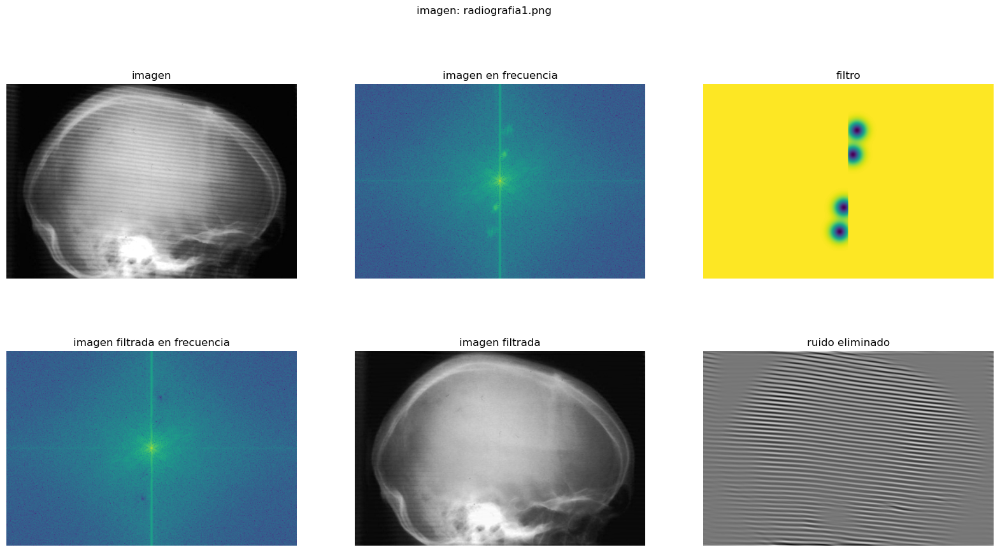

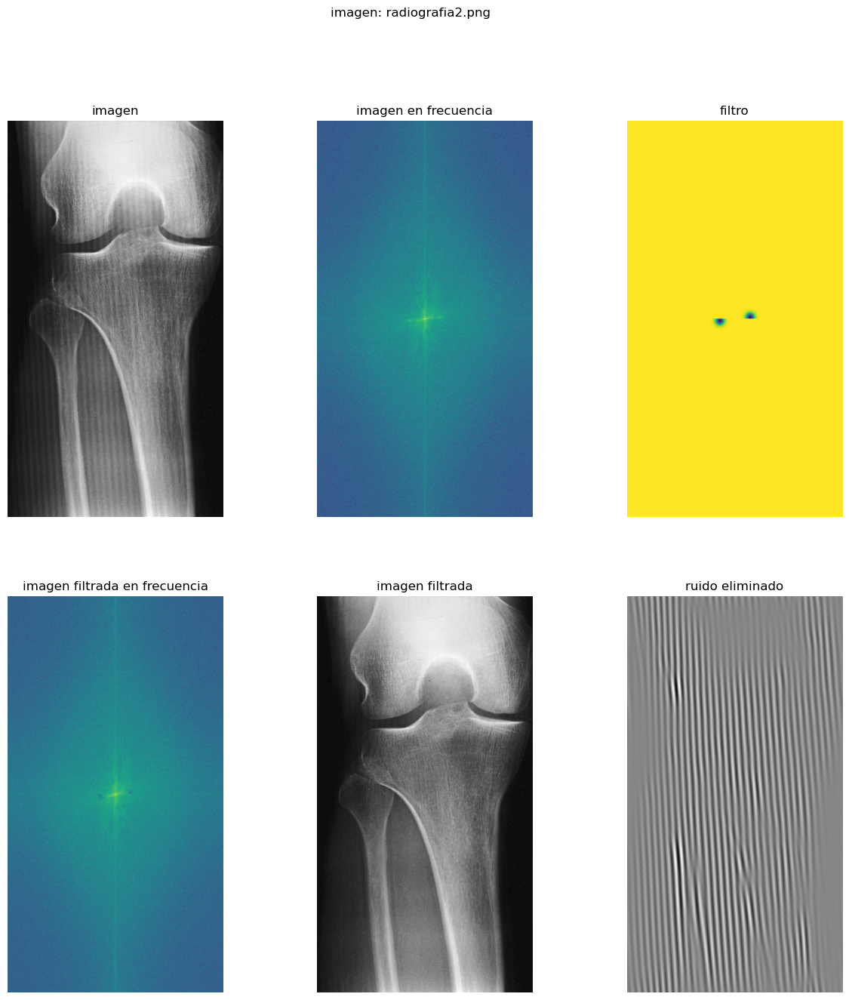

In [43]:
%matplotlib inline

# distncias de los puntos de interes al centro de la transformada shifteada (x,y)
puntos_radio1 = [(8, 46), (15, 88)]
puntos_radio2 = [(34, 4)]

sigmas_radio1 = [15, 15, 15, 15]
sigmas_radio2 = [10, 10]

infos = [[puntos_radio1, sigmas_radio1], [puntos_radio2, sigmas_radio2]]

imagenes = ["radiografia1.png",  "radiografia2.png"]

for str, info in zip(imagenes, infos):
   
    im = cv2.imread(f'imagenes/{str}')
    im_gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    im_f = fft2(im_gray)
    alto, ancho = im_f.shape
     
    u0s = [] #u=y
    v0s = [] #v=x

    for x, y in info[0]:
        # para cada punto con distancia al centro (x,y) de la imagen shifteada, 
        # agrego a la lista de u0s y v0s los puntos simetricos que sirven para trabajar con la transformada sin shiftear
        u0s.append(y)
        v0s.append(ancho-x)
        
        u0s.append(alto-y)
        v0s.append(x)
    
    sigmas = info[1]
    filtro = filtro_para_ruido_estructurado(im_f, u0s, v0s, sigmas)


    denoise_f = im_f * filtro

    denoise = np.abs(ifft2(denoise_f))

    if str=="radiografia1.png":
        fig, ax = plt.subplots(2, 3, figsize = (20,10))
        
    else:
        fig, ax = plt.subplots(2, 3, figsize = (15,15))
        
    ax[0,0].imshow(im_gray, cmap='gray')
    
    ax[0,1].imshow(np.log10(1 + np.abs(fftshift(im_f))))
    ax[0,2].imshow(np.log10(1 + np.abs(fftshift(filtro))))
    ax[1,0].imshow(np.log10(1 + np.abs(fftshift(denoise_f))))

    ax[1,1].imshow(denoise, cmap='gray')
    ax[1,2].imshow((denoise-im_gray), cmap='gray')
    


    titles = ["imagen", "imagen en frecuencia", "filtro", "imagen filtrada en frecuencia", "imagen filtrada", "ruido eliminado"]

    for i, a in enumerate(ax.ravel()):
        a.set_title(titles[i])
        a.axis("off")
        
    fig.suptitle(f'imagen: {str}')
    plt.show()
    
    #TODO PLOTEAR RUIDO ELIMINADO (IMG ORIGINAL - IMG FILTRADA)

Se puede ver como el filtro funciona de manera esperada, por un lado en el espacio, hace desaparecer en gran parte el ruido estructurado que tiene la imagen, mientras que en frecuencia, los puntos correspondientes a las sinusoides que forman este ruido estructurado se disminuyen considerablemente sin afectar el resto del espectro. Al observar el ruido eliminado se puede comprobar que no se esta eliminando información relevante de la imagen, ya que la diferencia entre la imagen filtrada y la original parece ser solamente las lineas que forman parte del ruido estructurado.
Al principio me daba un poco de dudas que los deltas en el filtro quedaran cortados de esa manera (ya que para la transformada sin shiftear caen muy cerca del borde), pero haciendo zoom en la transformada antes de ser filtrada observé que las componentes de los ruidos no pasan nunca a la otra mitad de la imagen, sino que pertenecen a un único cuadrante, por lo que tiene sentido que el filtro tenga esta forma.


**d)** **_Opcional_:** mostrar cómo se puede hacer en Fiji (a mano o mediante una macro)